In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import folium
from folium.plugins import MarkerCluster

In [2]:
crime_df = pd.read_csv("boston_crime2023.csv")

In [3]:
crime_df.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,232064809,3115,NaN,INVESTIGATE PERSON,A1,63,0,2023-01-01 00:00:00+00,2023,1,Sunday,0,NaN,LOMASNEY WAY,42.365368,-71.064512,"(42.36536762674733, -71.06451160899312)"
1,232000005,1831,NaN,SICK ASSIST,NaN,,0,2023-01-01 00:22:00+00,2023,1,Sunday,0,NaN,JERSEY STREET & VAN NESS STREET\nBOSTON MA 02...,NaN,NaN,NaN
2,232001890,1402,NaN,VANDALISM,A7,28,0,2023-01-06 09:00:00+00,2023,1,Friday,9,NaN,PARIS STREET,NaN,NaN,NaN
3,232010064,619,NaN,LARCENY ALL OTHERS,A1,77,0,2023-01-05 11:44:00+00,2023,1,Thursday,11,NaN,SUDBURY STREET,NaN,NaN,NaN
4,232000029,1831,NaN,SICK ASSIST,E18,,0,2023-01-01 01:57:00+00,2023,1,Sunday,1,NaN,GARFIELD AVE,42.244482,-71.118993,"(42.24448225252297, -71.11899292879615)"


In [4]:
crime_df.tail()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
48297,232048057,724,NaN,AUTO THEFT,A1,,0,2023-06-18 23:40:00+00,2023,6,Sunday,23,NaN,SUDBURY ST,NaN,NaN,NaN
48298,232049653,1402,NaN,VANDALISM,B2,331,0,2023-06-23 13:20:00+00,2023,6,Friday,13,NaN,SAYWARD STREET,NaN,NaN,NaN
48299,232049589,1102,NaN,FRAUD - FALSE PRETENSE / SCHEME,C6,,0,2023-06-24 08:44:00+00,2023,6,Saturday,8,NaN,SUMMER STREET,NaN,NaN,NaN
48300,232049713,3502,NaN,MISSING PERSON - LOCATED,C6,,0,2023-06-24 18:02:00+00,2023,6,Saturday,18,NaN,DISTRICT AVE,NaN,NaN,NaN
48301,232050406,3805,NaN,M/V ACCIDENT - POLICE VEHICLE,A7,26,0,2023-06-27 04:30:00+00,2023,6,Tuesday,4,NaN,BORDER STREET,NaN,NaN,NaN


# DATA CLEANING

In [5]:
print("Rows: ",crime_df.shape[0])
print("Columns: ",crime_df.shape[1])
crime_df.dtypes

Rows:  48302
Columns:  17


INCIDENT_NUMBER         object
OFFENSE_CODE             int64
OFFENSE_CODE_GROUP     float64
OFFENSE_DESCRIPTION     object
DISTRICT                object
REPORTING_AREA          object
SHOOTING                 int64
OCCURRED_ON_DATE        object
YEAR                     int64
MONTH                    int64
DAY_OF_WEEK             object
HOUR                     int64
UCR_PART               float64
STREET                  object
Lat                    float64
Long                   float64
Location                object
dtype: object

In [6]:
crime_df.isnull().sum()

INCIDENT_NUMBER            0
OFFENSE_CODE               0
OFFENSE_CODE_GROUP     48302
OFFENSE_DESCRIPTION        0
DISTRICT                 125
REPORTING_AREA             0
SHOOTING                   0
OCCURRED_ON_DATE           0
YEAR                       0
MONTH                      0
DAY_OF_WEEK                0
HOUR                       0
UCR_PART               48302
STREET                     0
Lat                     4413
Long                    4413
Location                4413
dtype: int64

In [7]:
crime_df.replace('-', np.nan, inplace=True)

In [8]:
crime_df.isnull().sum()

INCIDENT_NUMBER            0
OFFENSE_CODE               0
OFFENSE_CODE_GROUP     48302
OFFENSE_DESCRIPTION        0
DISTRICT                 125
REPORTING_AREA             0
SHOOTING                   0
OCCURRED_ON_DATE           0
YEAR                       0
MONTH                      0
DAY_OF_WEEK                0
HOUR                       0
UCR_PART               48302
STREET                     0
Lat                     4413
Long                    4413
Location                4413
dtype: int64

In [9]:
total_cells = np.product(crime_df.shape)
total_missing = crime_df.isna().sum()

# percent of data that is missing
(total_missing/total_cells) * 100

INCIDENT_NUMBER        0.000000
OFFENSE_CODE           0.000000
OFFENSE_CODE_GROUP     5.882353
OFFENSE_DESCRIPTION    0.000000
DISTRICT               0.015223
REPORTING_AREA         0.000000
SHOOTING               0.000000
OCCURRED_ON_DATE       0.000000
YEAR                   0.000000
MONTH                  0.000000
DAY_OF_WEEK            0.000000
HOUR                   0.000000
UCR_PART               5.882353
STREET                 0.000000
Lat                    0.537428
Long                   0.537428
Location               0.537428
dtype: float64

In [10]:
crime_df.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,232064809,3115,NaN,INVESTIGATE PERSON,A1,63,0,2023-01-01 00:00:00+00,2023,1,Sunday,0,NaN,LOMASNEY WAY,42.365368,-71.064512,"(42.36536762674733, -71.06451160899312)"
1,232000005,1831,NaN,SICK ASSIST,NaN,,0,2023-01-01 00:22:00+00,2023,1,Sunday,0,NaN,JERSEY STREET & VAN NESS STREET\nBOSTON MA 02...,NaN,NaN,NaN
2,232001890,1402,NaN,VANDALISM,A7,28,0,2023-01-06 09:00:00+00,2023,1,Friday,9,NaN,PARIS STREET,NaN,NaN,NaN
3,232010064,619,NaN,LARCENY ALL OTHERS,A1,77,0,2023-01-05 11:44:00+00,2023,1,Thursday,11,NaN,SUDBURY STREET,NaN,NaN,NaN
4,232000029,1831,NaN,SICK ASSIST,E18,,0,2023-01-01 01:57:00+00,2023,1,Sunday,1,NaN,GARFIELD AVE,42.244482,-71.118993,"(42.24448225252297, -71.11899292879615)"


In [11]:
crime_df = crime_df.drop('OFFENSE_CODE_GROUP', axis=1)

In [12]:
crime_df.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,232064809,3115,INVESTIGATE PERSON,A1,63,0,2023-01-01 00:00:00+00,2023,1,Sunday,0,NaN,LOMASNEY WAY,42.365368,-71.064512,"(42.36536762674733, -71.06451160899312)"
1,232000005,1831,SICK ASSIST,NaN,,0,2023-01-01 00:22:00+00,2023,1,Sunday,0,NaN,JERSEY STREET & VAN NESS STREET\nBOSTON MA 02...,NaN,NaN,NaN
2,232001890,1402,VANDALISM,A7,28,0,2023-01-06 09:00:00+00,2023,1,Friday,9,NaN,PARIS STREET,NaN,NaN,NaN
3,232010064,619,LARCENY ALL OTHERS,A1,77,0,2023-01-05 11:44:00+00,2023,1,Thursday,11,NaN,SUDBURY STREET,NaN,NaN,NaN
4,232000029,1831,SICK ASSIST,E18,,0,2023-01-01 01:57:00+00,2023,1,Sunday,1,NaN,GARFIELD AVE,42.244482,-71.118993,"(42.24448225252297, -71.11899292879615)"


In [13]:
crime_df.isnull().sum()

INCIDENT_NUMBER            0
OFFENSE_CODE               0
OFFENSE_DESCRIPTION        0
DISTRICT                 125
REPORTING_AREA             0
SHOOTING                   0
OCCURRED_ON_DATE           0
YEAR                       0
MONTH                      0
DAY_OF_WEEK                0
HOUR                       0
UCR_PART               48302
STREET                     0
Lat                     4413
Long                    4413
Location                4413
dtype: int64

In [14]:
crime_df = crime_df.drop('UCR_PART', axis=1)

In [15]:
crime_df.isnull().sum()

INCIDENT_NUMBER           0
OFFENSE_CODE              0
OFFENSE_DESCRIPTION       0
DISTRICT                125
REPORTING_AREA            0
SHOOTING                  0
OCCURRED_ON_DATE          0
YEAR                      0
MONTH                     0
DAY_OF_WEEK               0
HOUR                      0
STREET                    0
Lat                    4413
Long                   4413
Location               4413
dtype: int64

In [16]:
df_cleaned = crime_df.dropna()

In [17]:
df_cleaned.isnull().sum()

INCIDENT_NUMBER        0
OFFENSE_CODE           0
OFFENSE_DESCRIPTION    0
DISTRICT               0
REPORTING_AREA         0
SHOOTING               0
OCCURRED_ON_DATE       0
YEAR                   0
MONTH                  0
DAY_OF_WEEK            0
HOUR                   0
STREET                 0
Lat                    0
Long                   0
Location               0
dtype: int64

In [18]:
print("Rows: ",df_cleaned.shape[0])
print("Columns: ",df_cleaned.shape[1])
df_cleaned.dtypes

Rows:  43859
Columns:  15


INCIDENT_NUMBER         object
OFFENSE_CODE             int64
OFFENSE_DESCRIPTION     object
DISTRICT                object
REPORTING_AREA          object
SHOOTING                 int64
OCCURRED_ON_DATE        object
YEAR                     int64
MONTH                    int64
DAY_OF_WEEK             object
HOUR                     int64
STREET                  object
Lat                    float64
Long                   float64
Location                object
dtype: object

# DATA VISUALIZATION


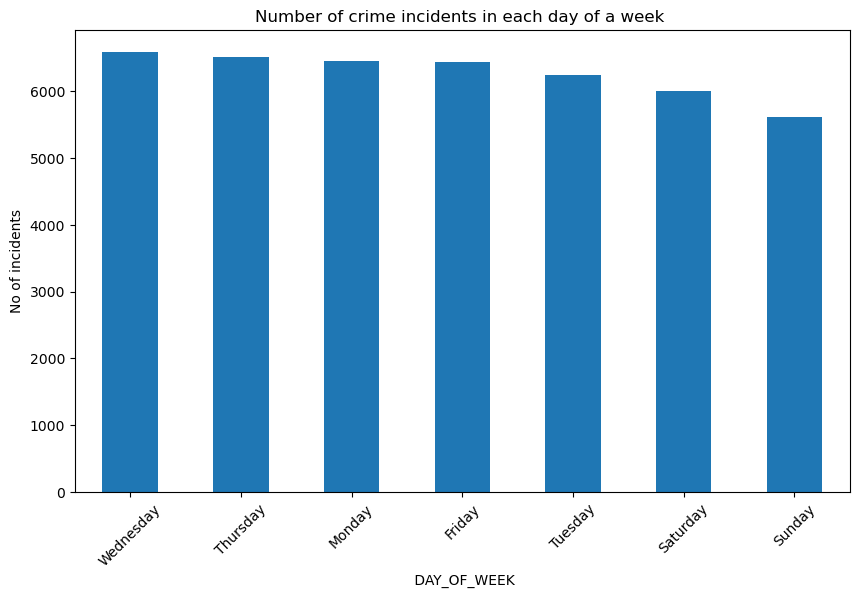

In [19]:

offense_counts = df_cleaned['DAY_OF_WEEK'].value_counts()

# Create a bar plot
offense_counts.plot(kind='bar', figsize=(10, 6))
plt.xlabel(' DAY_OF_WEEK')
plt.ylabel('No of incidents')
plt.title('Number of crime incidents in each day of a week ')
plt.xticks(rotation=45)  
plt.show()

<Axes: xlabel='MONTH'>

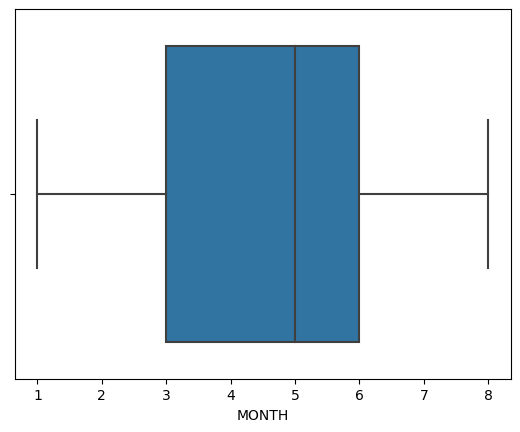

In [20]:
sns.boxplot(x=df_cleaned['MONTH'])

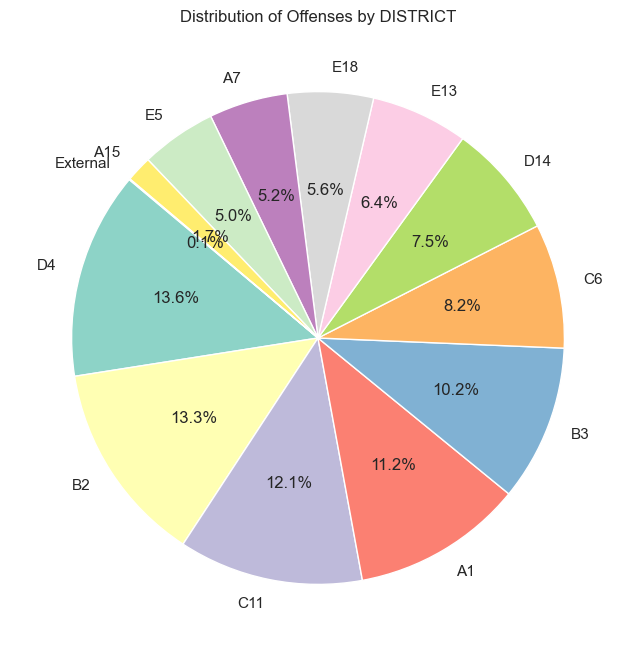

In [21]:
sns.set(style="whitegrid")
district_counts = df_cleaned['DISTRICT'].value_counts()
plt.figure(figsize=(8, 8))
plt.pie(district_counts, labels=district_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("Set3", len(district_counts)))
plt.title("Distribution of Offenses by DISTRICT")
plt.show()


C:\Users\ASUS\AppData\Local\Temp\ipykernel_8464\1796134012.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_cleaned.corr()


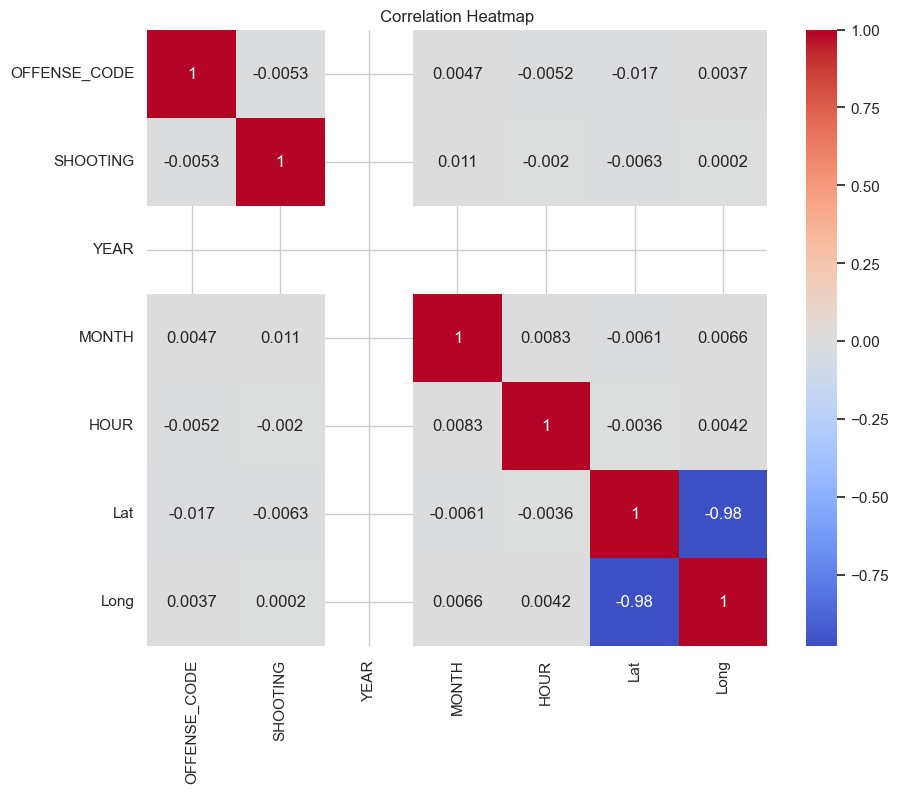

In [22]:
correlation_matrix = df_cleaned.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title("Correlation Heatmap")
plt.show()


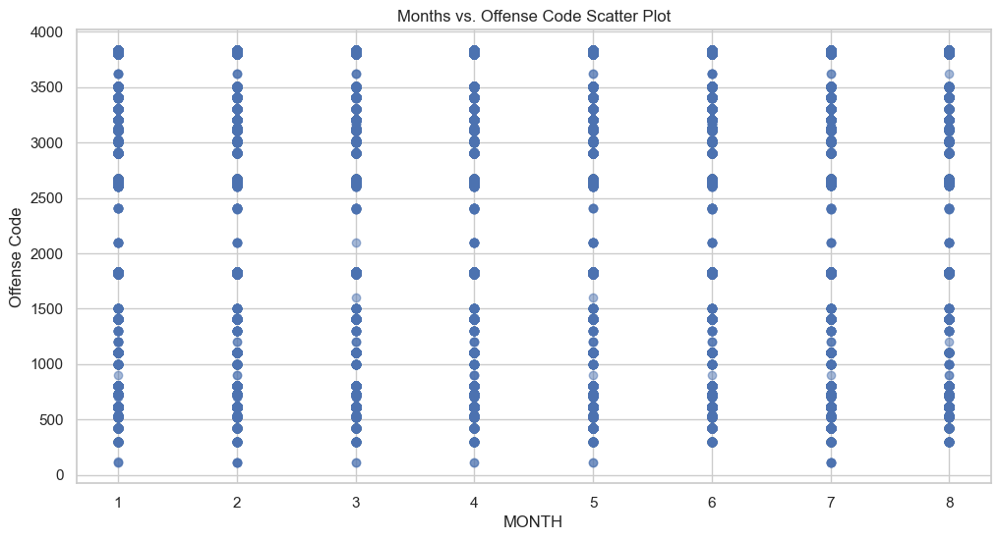

In [37]:
plt.figure(figsize=(12, 6))
plt.scatter(df_cleaned['MONTH'], df_cleaned['OFFENSE_CODE'], alpha=0.5)
plt.xlabel('MONTH')
plt.ylabel('Offense Code')
plt.title('Months vs. Offense Code Scatter Plot')
plt.show()

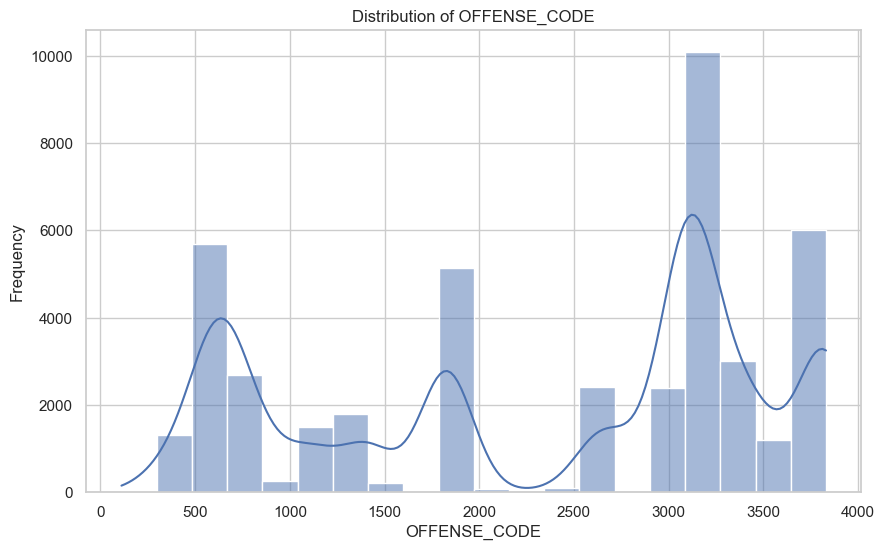

In [34]:
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.histplot(data=df_cleaned, x="OFFENSE_CODE", bins=20, kde=True)
plt.xlabel("OFFENSE_CODE")
plt.ylabel("Frequency")
plt.title("Distribution of OFFENSE_CODE")
plt.show()

In [39]:
map_center = [df_cleaned['Lat'].mean(), df_cleaned['Long'].mean()]
m = folium.Map(location=map_center, zoom_start=12)
marker_cluster = MarkerCluster().add_to(m)
for index, row in df_cleaned.iterrows():
    folium.Marker([row['Lat'], row['Long']], popup=row['OFFENSE_DESCRIPTION']).add_to(marker_cluster)
m.save("incident_map.html")
m